# Text to Image with Stable Diffusion XL

Make sure all dependencies are installed

In [ ]:
!pip install -r requirements.txt

Log into Hugging Face so you can download pretrained weights

In [ ]:
from huggingface_hub import interpreter_login
interpreter_login()

Let's create function to display images in notebookusing grid

In [1]:
from PIL import Image, ImageDraw

def image_grid(imgs, rows, cols, factor=1):
    assert len(imgs) == rows*cols

    w = int(imgs[0].size[0]/factor)
    h = int(imgs[0].size[1]/factor)
    grid = Image.new('RGB', size=(cols*w, rows*h))
    grid_w, grid_h = grid.size
    
    for i, img in enumerate(imgs):
        img = img.resize((w,h))
        grid.paste(img, box=(i%cols*w, i//cols*h))
    return grid

Define prompt

In [2]:
prompt = "High resolution photo of beautiful woman with thick glasses and rainbow colored hat and colorful parrot sitting on her shoulder. Photographic lighting, professional portrait, 4k, blurred background, f2.0"

## Simple text to image with base non-XL model only
All steps are going to be in latent space and then fed into decoder

In [ ]:
import torch
from diffusers import DiffusionPipeline, DPMSolverMultistepScheduler
import imageio

model_id = "stabilityai/stable-diffusion-2-1"

pipe = DiffusionPipeline.from_pretrained(model_id, 
                                        torch_dtype=torch.float16, 
                                        use_safetensors=True, 
                                        variant="fp16",
                                        add_watermarker = False)
pipe = pipe.to("cuda")

images = []
for i in range(4):
    images.append(pipe(prompt=prompt, num_images_per_prompt=1, num_inference_steps=50).images[0])

In [ ]:
# Add outputs to grid
grid = image_grid(images, rows=2, cols=2)

# Save file
grid.save("non-xl.png")

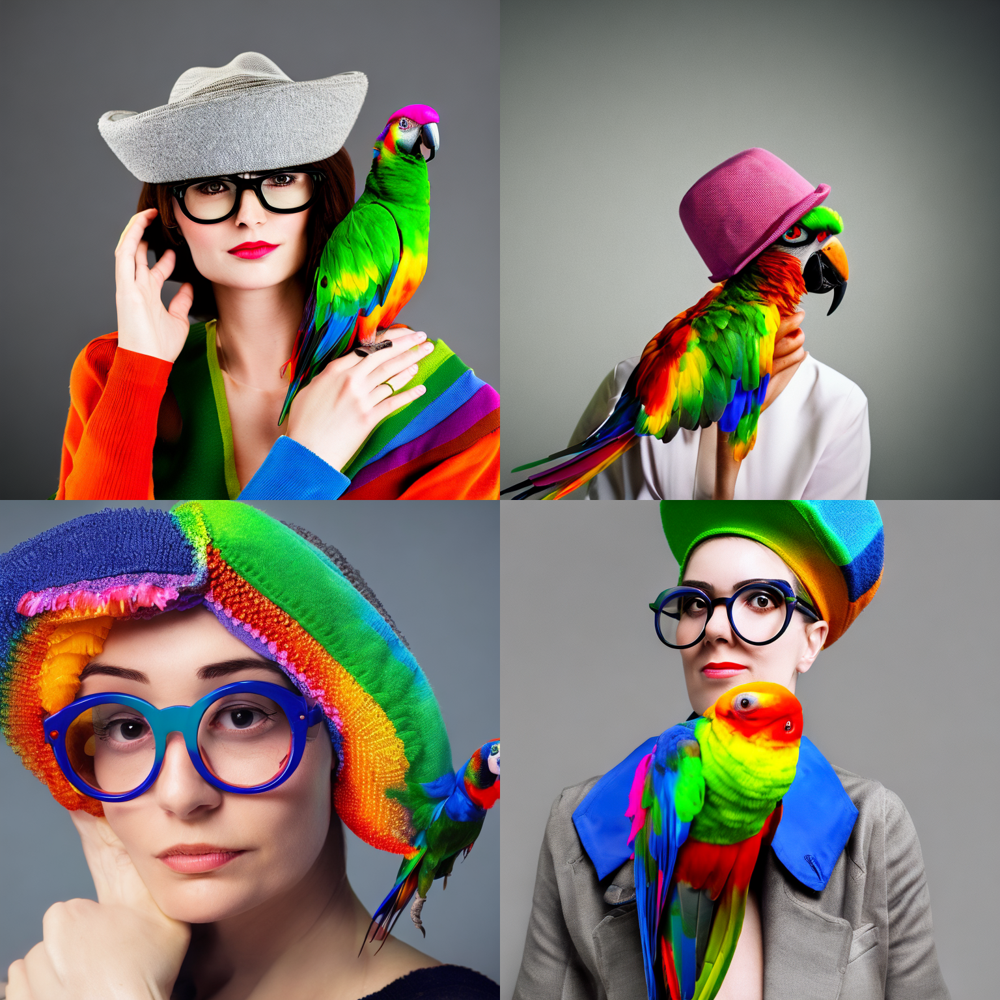

In [8]:
# Display grid in notebook
image = Image.open("non-xl.png")

# Display the image
image

## Simple text to image with base XL model only
All steps are going to be in latent space and then fed into decoder

In [ ]:
import torch
from diffusers import DiffusionPipeline, DPMSolverMultistepScheduler
import imageio

model_id = "stabilityai/stable-diffusion-xl-base-1.0"

pipe = DiffusionPipeline.from_pretrained(model_id, 
                                        torch_dtype=torch.float16, 
                                        use_safetensors=True, 
                                        variant="fp16",
                                        add_watermarker = False)
pipe = pipe.to("cuda")

images = []
for i in range(4):
    images.append(pipe(prompt=prompt, num_images_per_prompt=1, num_inference_steps=50).images[0])

In [26]:
# Add outputs to grid
grid = image_grid(images, rows=2, cols=2)

# Save file
grid.save("xl.png")

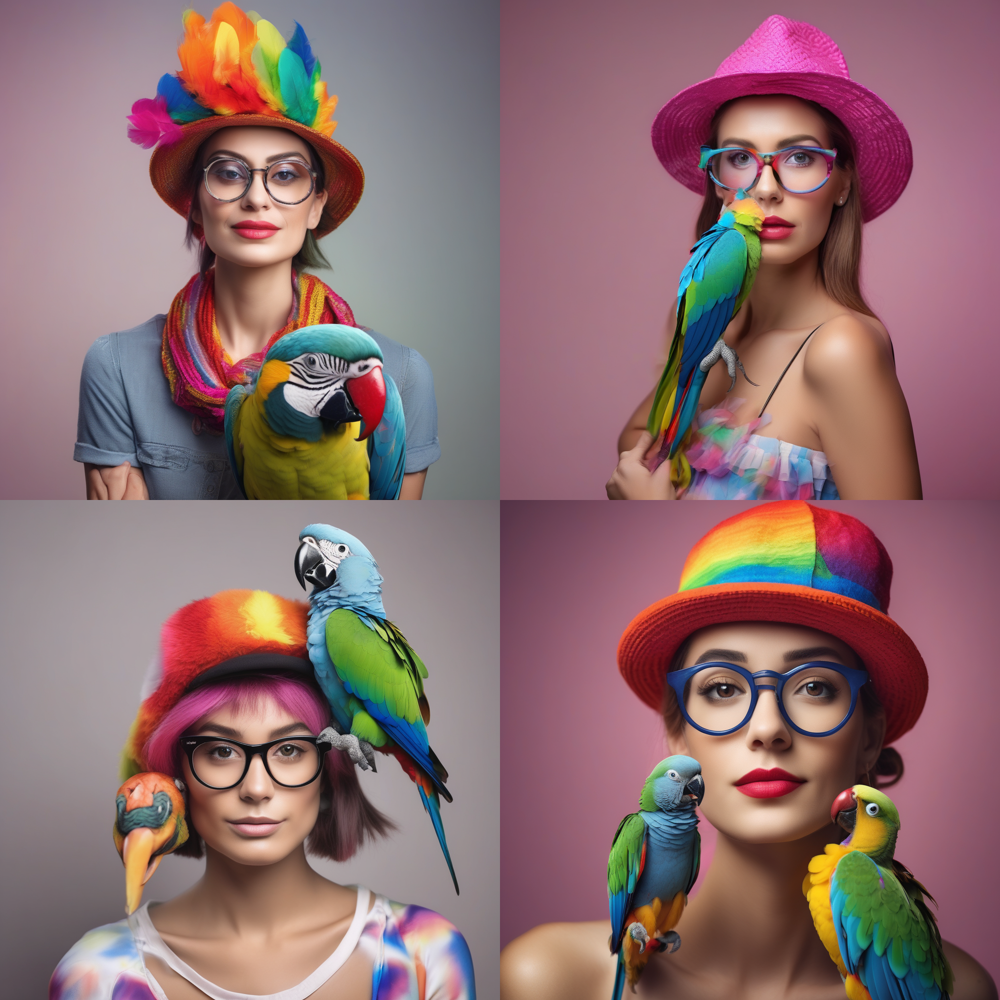

In [9]:
# Display grid in notebook
image = Image.open("xl.png")

# Display the image
image

Generate 64 images

In [ ]:
import torch
from diffusers import DiffusionPipeline, DPMSolverMultistepScheduler
import imageio

model_id = "stabilityai/stable-diffusion-xl-base-1.0"

pipe = DiffusionPipeline.from_pretrained(model_id, 
                                        torch_dtype=torch.float16, 
                                        use_safetensors=True, 
                                        variant="fp16",
                                        add_watermarker = False)
pipe = pipe.to("cuda")

images = []
for i in range(64):
    images.append(pipe(prompt=prompt, num_images_per_prompt=1, num_inference_steps=50).images[0])

In [4]:
# Add outputs to grid
grid = image_grid(images, rows=8, cols=8, factor=4)

# Save file
grid.save("xl-64.png")

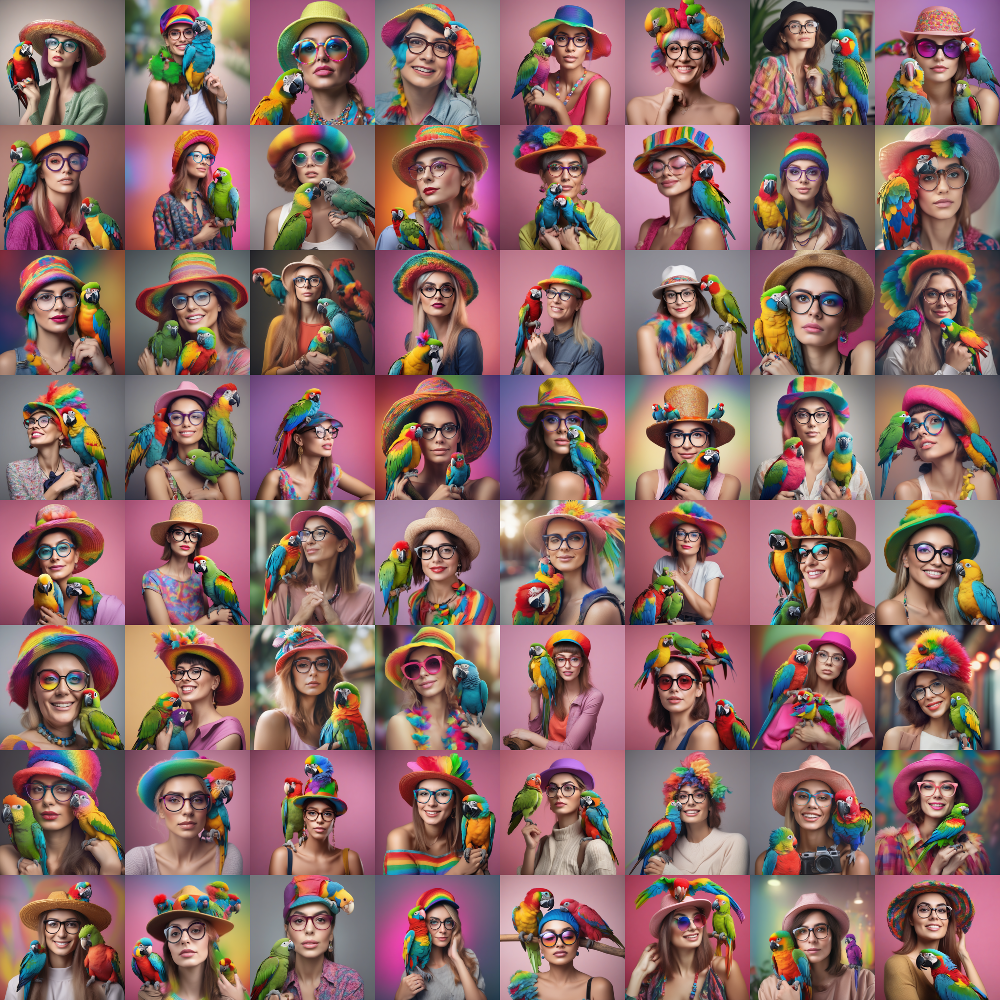

In [5]:
# Display grid in notebook
image = Image.open("xl-64.png")

# Display the image
image

## Enhanced results with refiner
Most steps will be done in latent space using base model, but we take outputs in latent space and use refiner to enhance results.

In [ ]:
import torch
from diffusers import DiffusionPipeline
import imageio

model_id = "stabilityai/stable-diffusion-xl-base-1.0"

num_inference_steps = 50
high_noise_frac = 0.8

base = DiffusionPipeline.from_pretrained(model_id, 
                                        torch_dtype=torch.float16, 
                                        use_safetensors=True, 
                                        variant="fp16",
                                        add_watermarker = False,)
base = base.to("cuda")

refiner = DiffusionPipeline.from_pretrained(
    "stabilityai/stable-diffusion-xl-refiner-1.0",
    text_encoder_2=base.text_encoder_2,
    vae=base.vae,
    torch_dtype=torch.float16,
    use_safetensors=True,
    variant="fp16",
)
refiner.to("cuda")

image = base(prompt=prompt, 
              num_images_per_prompt=1, 
              num_inference_steps=num_inference_steps,                
              denoising_end=high_noise_frac,
              output_type="latent").images

image = refiner(
    prompt=prompt,
    num_inference_steps=num_inference_steps,
    denoising_start=high_noise_frac,
    image=image).images[0]

image_grid([image], rows=1, cols=1)

In [6]:
# Add outputs to grid
grid = image_grid([image], rows=1, cols=1)

# Save file
grid.save("xl-refined.png")

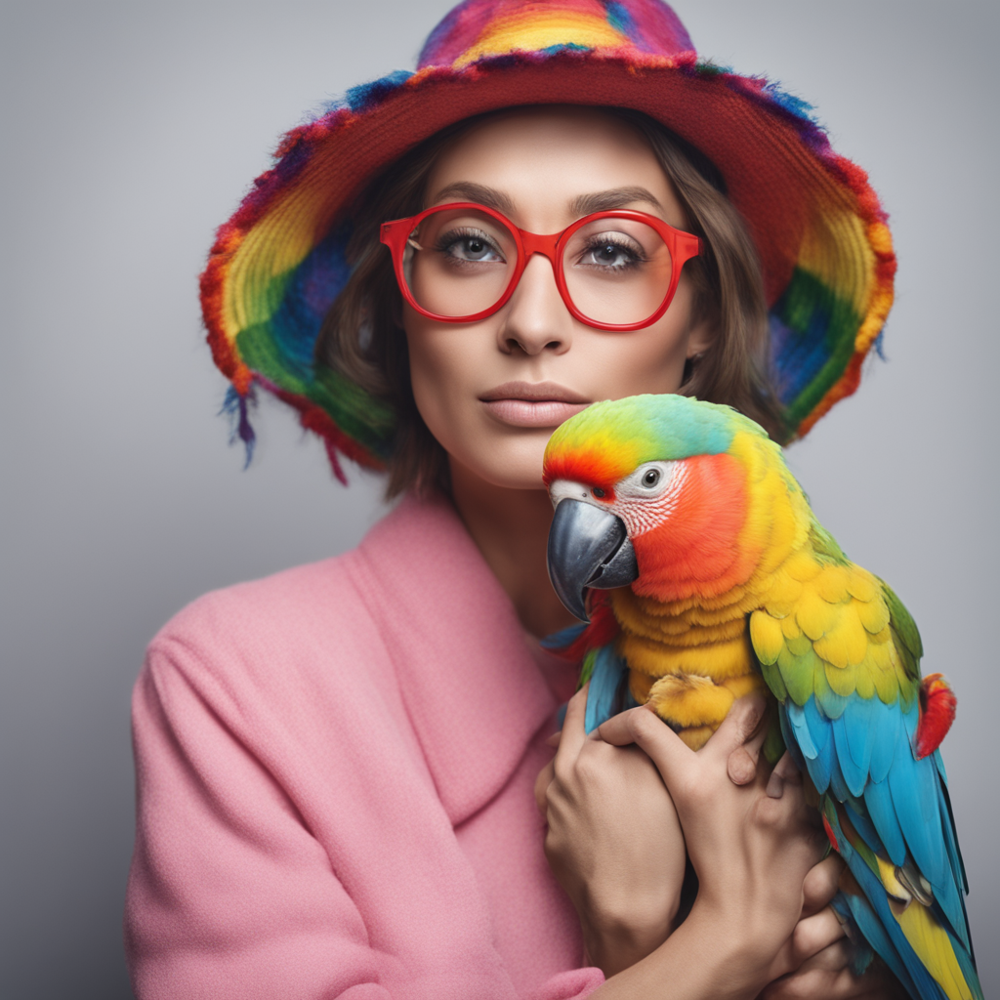

In [7]:
# Display grid in notebook
image = Image.open("xl-refined.png")

# Display the image
image